# Taller de Deep Learning
# Trabajo Obligatorio: Implementación de redes GAN
# Diciembre 2022

Mauricio Repetto 143045  
Juan Gabito 138616  
Federico de León 252047  

# Setup

In [ ]:
!sudo apt-get update
!sudo apt-get install imagemagick -y
!sudo apt-get dist-upgrade -y

Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Get:2 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Hit:3 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease
Hit:4 http://archive.ubuntu.com/ubuntu bionic InRelease
Ign:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Hit:7 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:8 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:9 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Hit:10 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu bionic InRelease
Get:12 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [83.3 kB]
Hit:13 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Get:14 http://security.ubuntu.com/ubuntu 

In [ ]:
!pip install torchinfo==1.7.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Set work environment

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Imports

In [ ]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1

In [ ]:
from typing import List, Tuple
import io

import torch
from torch import nn
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
from torchinfo import summary
from torch.utils.tensorboard import SummaryWriter

import pickle as pkl

import pandas as pd
import numpy as np

from collections import defaultdict

from PIL import Image

import matplotlib.pyplot as plt

from tqdm import tqdm_notebook

from sklearn.model_selection import train_test_split
from IPython import display as ipythondisplay
from pyvirtualdisplay import Display
import base64


import glob
import random
import time
from IPython.display import clear_output 
from IPython.display import Image as ipImage
from IPython.display import HTML

from os.path import exists
from os import chdir, makedirs

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
if exists("/content/drive/MyDrive/ORT/Posgrado AI/Taller DeepLearning/Obligatorio"):
  chdir("/content/drive/MyDrive/ORT/Posgrado AI/Taller DeepLearning/Obligatorio")
else:
  chdir('/content/drive/MyDrive/ORT/Taller DeepLearning/Obligatorio')

!ls

 data			       models
 generated_images	       obligatorio_taller_deep_learning.ipynb
 gifs			       PaperGAN.pdf
'Letra Obligatorio 2022.pdf'   runs
 Links.gdoc


Creamos algunas carpetas para organizar mejor los archivos...

In [ ]:
if not exists('generated_images'):
    makedirs('generated_images')

if not exists('models'):
    makedirs('models')

if not exists('gifs'):
    makedirs('gifs')

In [ ]:
SEED = 142

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

In [ ]:
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
DEVICE

device(type='cuda', index=0)

## Auxiliar functions

In [ ]:
def show_gan_progress(image_batches: List[np.array], gif_name: str, batch_size: int) -> None:
    """
    Generates an animated gif to show the progress of the generatof model of a gan.
    :param image_batches: the results of passing a batch of noise thru the generator model.
    :param gif_name: the name of the gif file
    """
    grid = int(np.sqrt(batch_size))
    
    # generate plots
    for i, batch in enumerate(image_batches):
        print(f'Generating images for batch {i}')
        _, axs = plt.subplots(grid, grid, figsize=(10, 10))
        axs = axs.flatten()
        for img, ax in zip(batch, axs):
            ax.set_xticks([])
            ax.set_yticks([])

            if (img.shape[2] == 1):
                ax.imshow(img.squeeze(2), cmap='gray')
            else:
                ax.imshow(img, cmap='gray')
        
        plt.suptitle(f'>> {i + 1} <<', y=-0.01) 
        plt.savefig(f'test_batch_{i}.png', bbox_inches='tight')  
        plt.show()
        clear_output()

    # generate gif
    gf = gif_name + '.gif'
    !convert  -delay 100 -loop 0 *.png $gf
    !rm -rf ./*.png

    # show gif
    display(ipImage(filename=f'./{gf}'))

In [ ]:
 # Functions to display the environment.

def show_gif_comparison(gif_simple, gif_simplew, gif_complexw):
    
    gif1 = glob.glob(f'./gifs/evaluation_{gif_simple}.gif')[0]
    gif1_bytes = io.open(gif1, 'r+b').read()
    encoded_v1 = base64.b64encode(gif1_bytes)

    gif2 = glob.glob(f'./gifs/evaluation_{gif_simplew}.gif')[0]
    gif2_bytes = io.open(gif2, 'r+b').read()
    encoded_v2 = base64.b64encode(gif2_bytes)

    gif3 = glob.glob(f'./gifs/evaluation_{gif_complexw}.gif')[0]
    gif3_bytes = io.open(gif3, 'r+b').read()
    encoded_v3 = base64.b64encode(gif3_bytes)


    ipythondisplay.display(HTML(
        data='''
            <table>
                <thead>
                    <th>Simple Model</th>
                    <th>Simple Model with Initial Weights</th>
                    <th>Complex Models with Initial Weights</th>
                <thead>
                <tbody>
                    <tr>
                        <td>
                          <img <source src="data:image/gif;base64,{0}" type="image/gif" height="400"/>
                          </img>
                        </td>
                        <td>
                          <img <source src="data:image/gif;base64,{1}" type="image/gif"  height="400"/>
                          </img>
                        </td>
                        <td>
                          <img <source src="data:image/gif;base64,{2}" type="image/gif"  height="400"/>
                          </img>
                        </td>
                    </tr>
                <tbody>
            </table>

        '''.format(encoded_v1.decode('ascii'),encoded_v2.decode('ascii'),encoded_v3.decode('ascii'))))


# Datasets

## MNIST

In [ ]:
mnist_train = datasets.MNIST(root='./data', train=True, download=True, transform=None)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



In [ ]:
mnist_test = datasets.MNIST(root='./data', train=False, download=True, transform=None)

In [ ]:
classes = mnist_train.classes
print(f"Clases: {classes}")
print(f"Train set: {len(mnist_train):,}")
print(f"Test set: {len(mnist_test):,}")

Clases: ['0 - zero', '1 - one', '2 - two', '3 - three', '4 - four', '5 - five', '6 - six', '7 - seven', '8 - eight', '9 - nine']
Train set: 60,000
Test set: 10,000


Ejemplo:

Clase 5
Tamaño de la imagen: 28x28


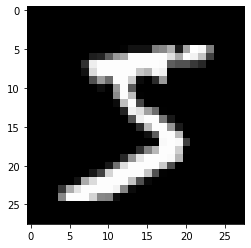

In [ ]:
image, label = mnist_train[0] 
w, h = image.size
print(f"Clase {label}")
print(f"Tamaño de la imagen: {w}x{h}")

plt.imshow(image, cmap='gray')
plt.show()

### Class distribution

In [ ]:
mnist_class_freqs = defaultdict(lambda: 0)
for _, lbl in mnist_train:
    mnist_class_freqs[lbl]+=1

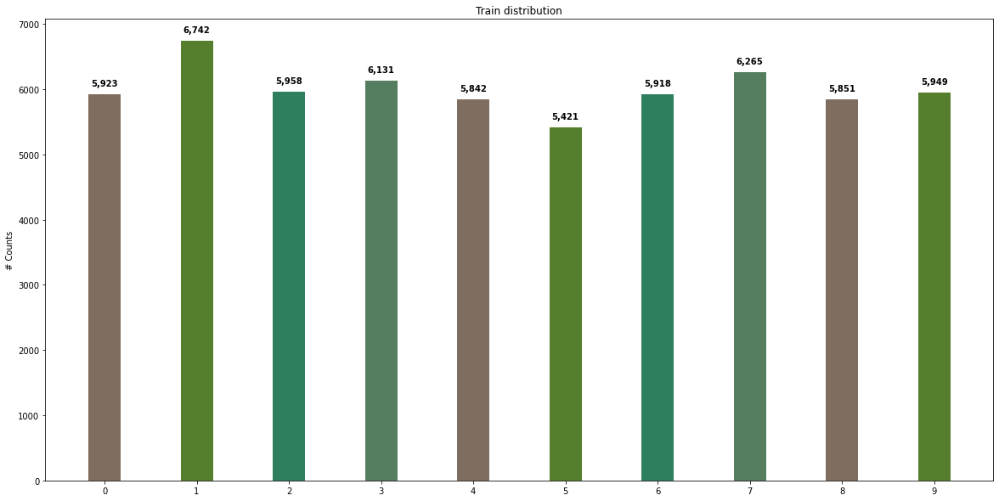

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in mnist_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [mnist_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Train distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

In [ ]:
mnist_class_freqs = defaultdict(lambda: 0)
for _, lbl in mnist_test:
    mnist_class_freqs[lbl]+=1

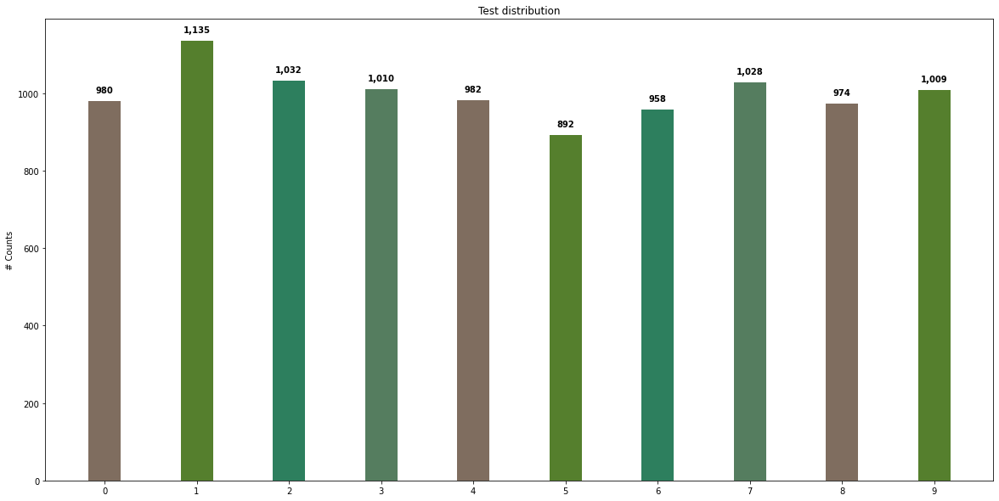

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in mnist_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [mnist_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Test distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

## FashionMNIST

In [ ]:
fmnist_train = datasets.FashionMNIST(root='./data', train=True, download=True, transform=None)

  0%|          | 0/26421880 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/train-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/29515 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/4422102 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./data/FashionMNIST/raw



  0%|          | 0/5148 [00:00<?, ?it/s]

Extracting ./data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/FashionMNIST/raw



In [ ]:
fmnist_test = datasets.FashionMNIST(root='./data', train=False, download=True, transform=None)

In [ ]:
print(f"Clases: {fmnist_train.classes}")
print(f"Train set: {len(fmnist_train):,}")
print(f"Test set: {len(fmnist_test):,}")

Clases: ['T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat', 'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot']
Train set: 60,000
Test set: 10,000


Ejemplo:

Clase 9
Tamaño de la imagen: 28x28


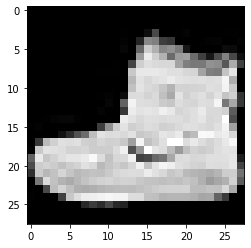

In [ ]:
image, label = fmnist_train[0] 
w, h = image.size
print(f"Clase {label}")
print(f"Tamaño de la imagen: {w}x{h}")

plt.imshow(image, cmap='gray')
plt.show()

### Class distribution

In [ ]:
fmnist_class_freqs = defaultdict(lambda: 0)
for _, lbl in fmnist_train:
    fmnist_class_freqs[lbl]+=1

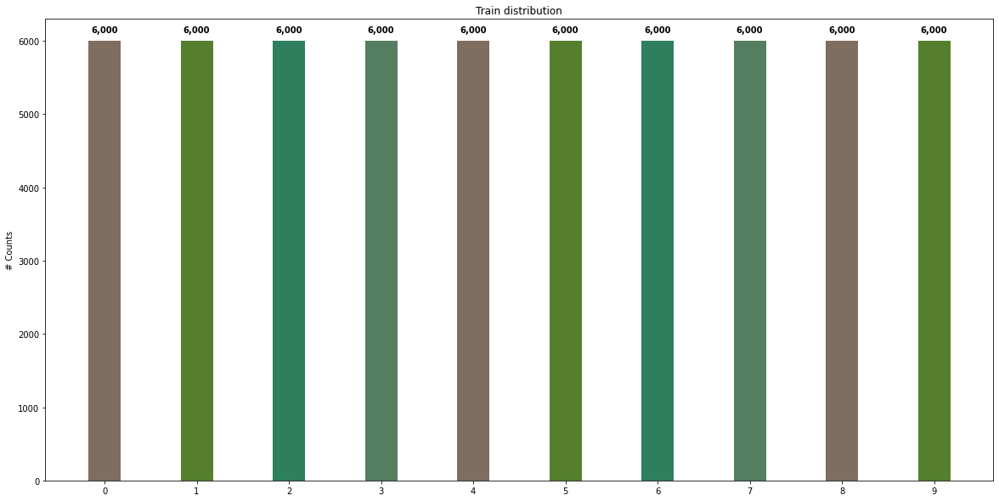

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in fmnist_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [fmnist_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Train distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

In [ ]:
fmnist_class_freqs = defaultdict(lambda: 0)
for _, lbl in fmnist_test:
    fmnist_class_freqs[lbl]+=1

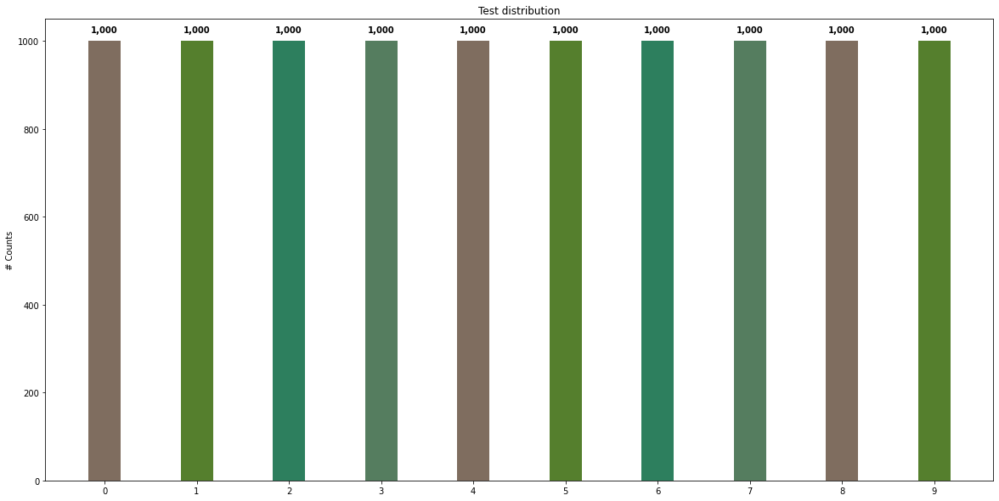

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in fmnist_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [fmnist_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Test distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

## CIFAR10

In [ ]:
cifar10_train = datasets.CIFAR10(root='./data', train=True, download=True, transform=None)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./data/cifar-10-python.tar.gz to ./data


In [ ]:
cifar10_test = datasets.FashionMNIST(root='./data', train=False, download=True, transform=None)

In [ ]:
print(f"Clases: {cifar10_train.classes}")
print(f"Train set: {len(cifar10_train):,}")
print(f"Test set: {len(cifar10_test):,}")

Clases: ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
Train set: 50,000
Test set: 10,000


Ejemplo:

Clase 6
Tamaño de la imagen: 32x32


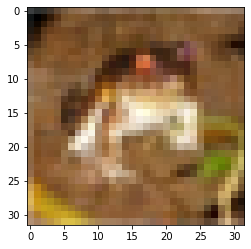

In [ ]:
image, label = cifar10_train[0] 
w, h = image.size
print(f"Clase {label}")
print(f"Tamaño de la imagen: {w}x{h}")

plt.imshow(image, cmap='gray')
plt.show()

### Class distribution

In [ ]:
cifar10_class_freqs = defaultdict(lambda: 0)
for _, lbl in cifar10_train:
    cifar10_class_freqs[lbl]+=1

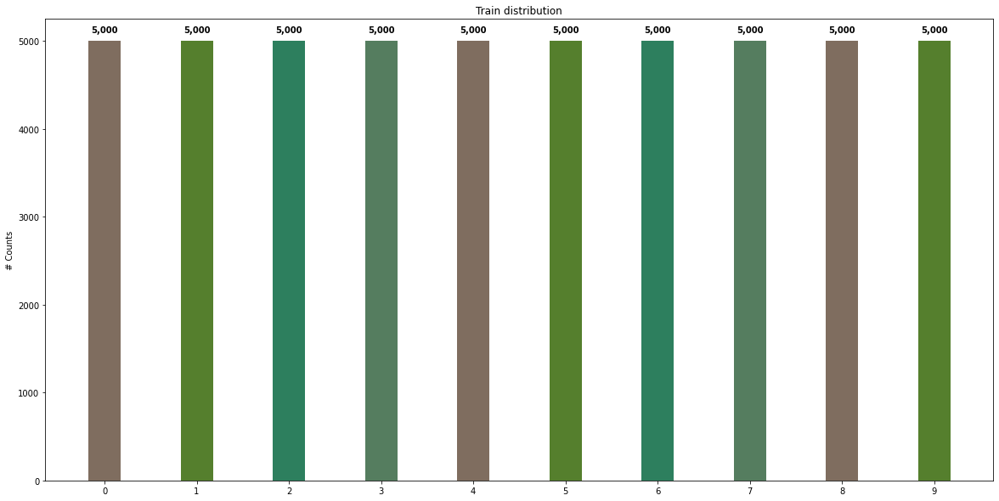

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in cifar10_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [cifar10_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Train distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

In [ ]:
cifar10_class_freqs = defaultdict(lambda: 0)
for _, lbl in cifar10_test:
    cifar10_class_freqs[lbl]+=1

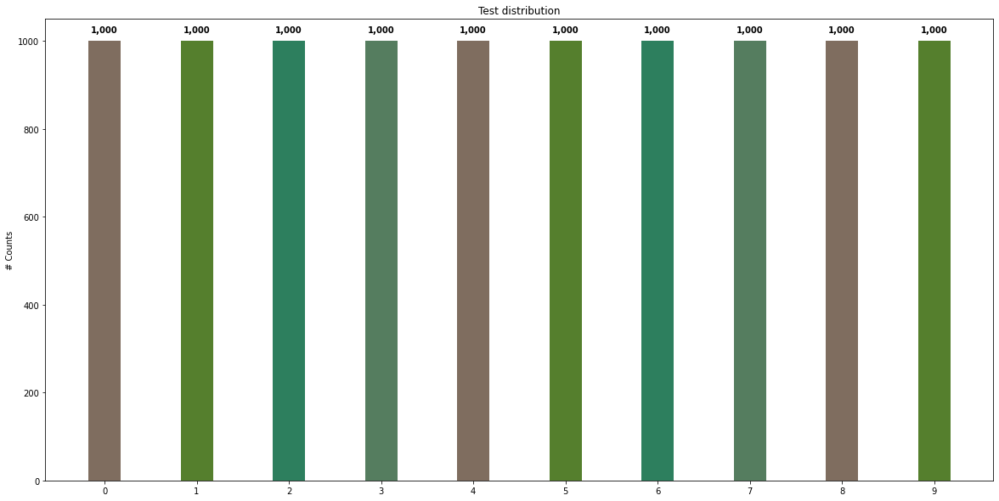

In [ ]:
plt.figure(figsize=(20,10))

labels = [l for l in cifar10_class_freqs.keys()]
sort_ixs = np.argsort(labels)
labels = [labels[i] for i in sort_ixs]
values = [cifar10_class_freqs[l] for l in labels]

x_locs = np.arange(len(labels))
bar_plot_width = 0.35

plt.bar(labels, values, bar_plot_width, color=['#7f6d5f','#557f2d','#2d7f5e','#557d5f'])
plt.title('Test distribution')
plt.ylabel('# Counts')
plt.xticks(x_locs, labels=labels)

for x, y in zip(labels, values):
    plt.annotate(s=f'{y:,}',
                 xy=(x,y), 
                 textcoords="offset points",
                 xytext=(0,10), 
                 ha='center',
                 fontweight='bold')

# Training

## Parameters

In [ ]:
# for data loaders
BATCH_SIZE = 64
NUM_WORKERS = 2

# Size of z latent vector (i.e. size of generator input)
LATENT_VECTOR_SIZE = 100

NUM_EPOCHS = 2000
LR = 0.0002

# Beta1 hyperparam for Adam optimizers
BETA1 = 0.5

## Functions

### Loss

In [ ]:
# code inspired from https://github.com/Garima13a/MNIST_GAN/blob/master/MNIST_GAN_Solution.ipynb
def real_loss(discriminator_output: torch.Tensor, criterion:nn.Module, smooth=False):
    """
    Computes model loss on real labels.
    :param discriminator_output: discriminator model output.
    :param criterion: criterion for loss calculation.
    :param smooth: to smooth the predictions.
    """
    batch_size = discriminator_output.size(0)
    
    # real labels = 1s
    labels = torch.ones(batch_size).to(DEVICE) 
    if smooth:
        labels = labels * 0.9
        
    loss = criterion(discriminator_output.squeeze(), labels)
    
    return loss

def fake_loss(discriminator_output: torch.Tensor, criterion:nn.Module):
    """
    Computes model loss on fake labels.
    :param discriminator_output: discriminator model output.
    :param criterion: criterion for loss calculation.
    """
    batch_size = discriminator_output.size(0)
    
    # fake labels = 0s
    labels = torch.zeros(batch_size).to(DEVICE) 
    loss = criterion(discriminator_output.squeeze(), labels)
    
    return loss

### Training logic

In [ ]:
# code inspired from https://pytorch.org/vision/stable/_modules/torchvision/utils.html#make_grid
def adjust_image(generator_output: torch.Tensor, channels: int, image_size: int, normalize: bool = False) -> torch.Tensor:
    """
    Adjusts the generated image from the generator model.
    :param generator_output: the tensor output from the generator model.
    :return: the image resulting from the generator model.
    """
    if normalize:
        low = float(generator_output.min()) 
        high = float(generator_output.max())
        generator_output.clamp_(min=low, max=high)
        generator_output.sub_(low).div_(max(high - low, 1e-5))

    # reconstruct the image
    return np.transpose(generator_output.reshape((channels, image_size, image_size)), (1, 2, 0))

In [ ]:
def save_models(generator: nn.Module, discriminator: nn.Module, experiment_name: str, checkpoint: bool = False):
    """
    Saves two models weights.
    :param generator: generator model to save.
    :param discriminator: discriminator model to save.
    :param experiment_name: to use as part of the file name.
    :param checkpoint: if this is a checkpoint save or final one.
    """
    time_str = time.strftime("%Y%m%d-%H%M%S")

    file_path_dis = f'./models/discriminator_{experiment_name}_{time_str}.pt'
    file_path_gen = f'./models/generator_{experiment_name}_{time_str}.pt'

    if checkpoint:
        file_path_dis = f'./models/discriminator_{experiment_name}_ck.pt'    
        file_path_gen = f'./models/generator_{experiment_name}_ck.pt'
    
    torch.save(discriminator.state_dict(), file_path_dis) 
    torch.save(generator.state_dict(), file_path_gen)    

In [ ]:
def eval_generator(model: nn.Module, noise: torch.Tensor) -> torch.Tensor:
    """
    Evaluates a model with the provided noise.
    :param model: model for evaluation.
    :param noise: data for evaluation.
    :return: generator's output.
    """
    model.eval()    
    with torch.no_grad():
        generation = model(noise).detach().cpu()
    return generation

In [ ]:
def save_generator_check_progress(imgs_generated: List[np.array], experiment_name: str) -> None:
    with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'wb') as f:
        pkl.dump(imgs_generated, f)

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
# and https://github.com/Garima13a/MNIST_GAN/blob/master/MNIST_GAN_Solution.ipynb
def train_epoch(generator_model: nn.Module, discriminator_model: nn.Module, loader: DataLoader, criterion: nn.Module, 
                optimizerG: torch.optim.Optimizer, optimizerD: torch.optim.Optimizer, 
                latent_vector_size: int, conv_transpose: bool = False) -> Tuple[float, float]:
    """
    Trains two models in one epoch with the provided data for training using a given loss funcion and one optimizer for each model.
    :param generator: generator model to train.
    :param discriminator: discriminator model to train.
    :param loader: data for training.
    :param criterion: loss function.
    :param optimizerG: optimizer for generator.
    :param optimizerD: optimizer for discriminator.
    :param latent_vector_size: size of the latent space.
    """
    generator_model.train()
    discriminator_model.train()
    epochG_loss = 0.0
    epochD_loss = 0.0
    for i, (images, labels) in enumerate(loader, 0):
        images = images.to(DEVICE)
        # labels = labels.to(DEVICE)

        batch_size = images.size(0)
        
        ### Training Discriminator ###
        optimizerD.zero_grad()
        
        # 1. Train with real images

        # Compute the discriminator losses on real images 
        # smooth the real labels
        predictionsD_real = discriminator_model(images)
        lossd_real = real_loss(predictionsD_real, criterion, smooth=True)
        
        # 2. Train with fake images
        
        # Generate fake images
        noise = torch.randn(batch_size, latent_vector_size, device=DEVICE) if not conv_transpose \
            else torch.randn(batch_size, latent_vector_size, 1, 1, device=DEVICE)
        fake_images = generator_model(noise)
        
        # Compute the discriminator losses on fake images        
        predictionsD_fake = discriminator_model(fake_images)
        lossd_fake = fake_loss(predictionsD_fake, criterion)
        
        # add up loss and perform backprop
        lossd = lossd_real + lossd_fake
        lossd.backward()
        torch.nn.utils.clip_grad_norm_(discriminator_model.parameters(), max_norm=0.5)
        optimizerD.step()
        
        
        ### Training Generator ###
        optimizerG.zero_grad()
        
        # 1. Train with fake images and flipped labels
        
        # Generate fake images
        noise = torch.randn(batch_size, latent_vector_size, device=DEVICE) if not conv_transpose \
            else torch.randn(batch_size, latent_vector_size, 1, 1, device=DEVICE)
        fake_images = generator_model(noise)
        
        # Compute the discriminator losses on fake images 
        # using flipped labels!
        predictionsD_fake = discriminator_model(fake_images)
        lossg = real_loss(predictionsD_fake, criterion) # use real loss to flip labels
        
        # perform backprop
        lossg.backward()
        torch.nn.utils.clip_grad_norm_(generator_model.parameters(), max_norm=0.5)
        optimizerG.step()

        # acumulate losses
        epochG_loss+=lossg.item()
        epochD_loss+=lossd.item()
    
    return epochG_loss / len(loader), epochD_loss / len(loader)
    

def training_GANs(generator: nn.Module, discriminator: nn.Module, train_loader: DataLoader ,
                criterion: nn.Module, 
                optimizerG: torch.optim.Optimizer, optimizerD: torch.optim.Optimizer, 
                number_epochs: int, writer_name: str, latent_vector_size: int,
                fixed_noise: torch.Tensor, channels: int, image_size: int, 
                conv_transpose: bool = False, model_checkpoint_frequency: int = 250,
                generator_check_progress_frequency: int = 250) -> None:
    """
    Trains two models with the provided data for training and validation using a given loss funcion and optimizer.
    :param generator: generator model to train.
    :param discriminator: discriminator model to train.
    :param train_loader: data for training.
    :param criterion: loss function.
    :param optimizerG: optimizer for generator.
    :param optimizerD: optimizer for discriminator.
    :param number_epochs: number of epochs for training.
    :param writer_name: name for the summary file generated with the metrics collected.
    :param latent_vector_size: size of the latent space.
    :param fixed_noise: a fixed noise to evaluate generator's performance.
    :param model_checkpoint_frequency: frequency to make checkpoints of the models.
    """
    writer = SummaryWriter(comment=f">>> {writer_name}")
    imgs_generated = []

    # we saved the first output from the generator without training
    fake = eval_generator(generator, fixed_noise)
    imgs_generated.append([adjust_image(img, channels, image_size, normalize=True) for img in fake])
    save_generator_check_progress(imgs_generated, writer_name)

    for epoch in range(number_epochs):
        start_time = time.time()
        lossg, lossd = train_epoch(generator, discriminator, train_loader, criterion, optimizerG, optimizerD, latent_vector_size, 
                                   conv_transpose=conv_transpose)        
        print(f"Training epoch {epoch + 1} | Loss G {lossg:.6f} | Loss D {lossd:.6f}% | Time {time.time() - start_time:.2f} seconds")
        
        # clear output every 50 epochs
        if ((epoch + 1) % 50 == 0):
            clear_output()

        # save a checkpoint every X epochs
        if ((epoch + 1) % model_checkpoint_frequency == 0):
            save_models(generator, discriminator, experiment_name=writer_name, checkpoint=True)
            
        writer.add_scalar("loss_G", lossg, epoch)
        writer.add_scalar("loss_D", lossd, epoch)

        # Check how the generator is doing by saving G's output on fixed a noise
        if ((epoch + 1) % generator_check_progress_frequency == 0) or epoch == number_epochs - 1:
            fake = eval_generator(generator, fixed_noise)            
            imgs_generated.append([adjust_image(go, channels, image_size, normalize=True) for go in fake])
            save_generator_check_progress(imgs_generated, writer_name)
    
    writer.close()

    save_models(generator, discriminator, experiment_name=writer_name)

    return imgs_generated       

### Weight function

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
    elif classname.find('Linear') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)

# MNIST GAN

## Additional training parameters

In [ ]:
IMAGE_SIZE = 28
NUM_CHANNELS = 1

## Reload and transform

Consideramos que hay suficiente cantidad de ejemplos para cada clase sin problemas de desbalances, por esa razón no vamos a estar utilizando ninguna técnica de data augmentation ni de balanceo.

In [ ]:
transformations = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
mnist_train = datasets.MNIST(root='./data', train=True, download=True, transform=transformations)
mnist_test = datasets.MNIST(root='./data', train=False, download=True, transform=transformations)

## Data partition

In [ ]:
targets = mnist_train.targets

In [ ]:
train_idx, valid_idx= train_test_split(np.arange(len(mnist_train)), test_size=0.2, shuffle=True, stratify=targets)

train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)

## Loaders

In [ ]:
train_loader = torch.utils.data.DataLoader(mnist_train, batch_size=BATCH_SIZE, shuffle=True, pin_memory=True, num_workers=NUM_WORKERS)
# val_loader = torch.utils.data.DataLoader(mnist_train, batch_size=BATCH_SIZE, sampler=valid_sampler, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

test_loader = DataLoader(mnist_test, batch_size=BATCH_SIZE, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

print(f"{len(mnist_train):,} Training images. \n{len(mnist_test):,} Test images.")

60,000 Training images. 
10,000 Test images.


## Simple Models

### Generator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, width: int, height: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope
        self.channels = channels

        self.fc1 = nn.Linear(latent_vector_size, 256)
        self.fc2 = nn.Linear(256, 512)
        self.fc3 = nn.Linear(512, 1024)
        self.fc4 = nn.Linear(1024, channels * width * height)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = F.tanh(self.fc4(x))
        return output

### Discriminator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleDiscriminator(nn.Module):
    def __init__(self, width: int, height: int, channels: int = 1, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope

        self.fc1 = nn.Linear(channels * width * height, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, num_classes)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x.view(x.shape[0], -1)), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = self.fc4(x) # F.sigmoid(self.fc4(x))
        return output

### Models creation

In [ ]:
simple_generator = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope = 0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/generator_XXX_ck.pt'))

In [ ]:
summary(simple_generator, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 784]                  --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 784]                  803,600
Total params: 1,486,352
Trainable params: 1,486,352
Non-trainable params: 0
Total mult-adds (M): 1.49
Input size (MB): 0.00
Forward/backward pass size (MB): 0.02
Params size (MB): 5.95
Estimated Total Size (MB): 5.97

In [ ]:
simple_discriminator = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope=0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/discriminator_XXX_ck.pt'))

In [ ]:
summary(simple_discriminator, (1, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 803,840
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 1,460,225
Trainable params: 1,460,225
Non-trainable params: 0
Total mult-adds (M): 1.46
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 5.84
Estimated Total Size (MB): 5.86

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generator.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminator.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgs_generated = training_GANs(generator=simple_generator, discriminator=simple_discriminator, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simple_mnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

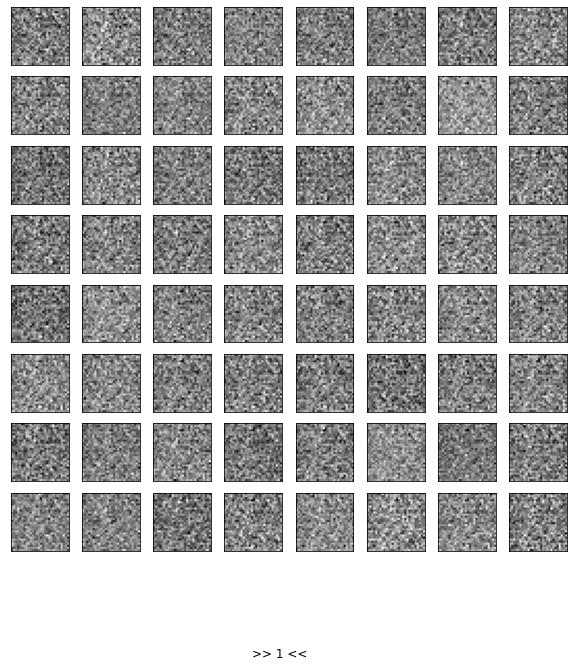

In [ ]:
experiment_name = 'simple_mnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Simple Models with initial weights

### Models creation

In [ ]:
simple_generatorw = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope = 0.2).to(DEVICE)
simple_generatorw.apply(weights_init)

SimpleGenerator(
  (fc1): Linear(in_features=100, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=1024, bias=True)
  (fc4): Linear(in_features=1024, out_features=784, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_generatorw, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 784]                  --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 784]                  803,600
Total params: 1,486,352
Trainable params: 1,486,352
Non-trainable params: 0
Total mult-adds (M): 1.49
Input size (MB): 0.00
Forward/backward pass size (MB): 0.02
Params size (MB): 5.95
Estimated Total Size (MB): 5.97

In [ ]:
simple_discriminatorw = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope=0.2).to(DEVICE)
simple_discriminatorw.apply(weights_init)

SimpleDiscriminator(
  (fc1): Linear(in_features=784, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=1, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_discriminatorw, (1, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 803,840
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 1,460,225
Trainable params: 1,460,225
Non-trainable params: 0
Total mult-adds (M): 1.46
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 5.84
Estimated Total Size (MB): 5.86

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgsw_generated = training_GANs(generator=simple_generatorw, discriminator=simple_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simplew_mnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

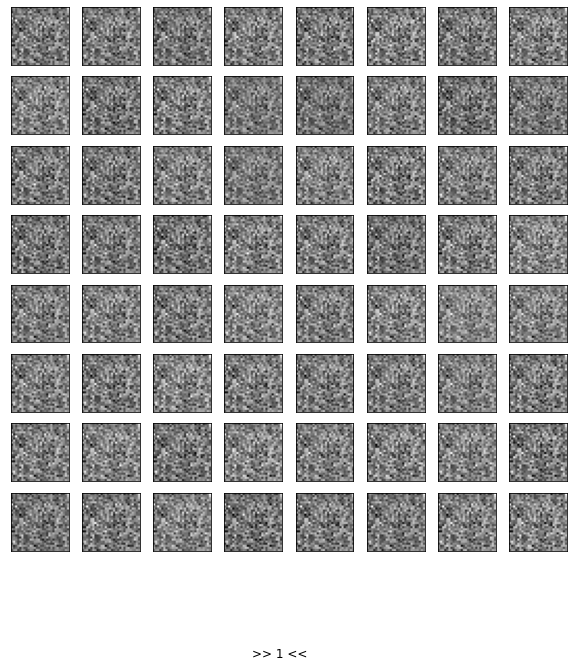

In [ ]:
experiment_name = 'simplew_mnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Complex Models with initial weights

### More additional training parameters

In [ ]:
# Size of feature maps in generator and discriminator
GENERATOR_FEATURES_MAP_SIZE = 28
DISCRIMINATOR_FEATURES_MAP_SIZE = 28

### Generator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, output_size: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.channels = channels
        
        self.sequential = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_vector_size, out_channels=output_size * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.ReLU(inplace=True),
            # state size. (os*8) x 4 x 4
            nn.ConvTranspose2d(output_size * 8, output_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.ReLU(inplace=True),
            # state size. (os*4) x 8 x 8
            nn.ConvTranspose2d( output_size * 4, output_size, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size),
            nn.ReLU(inplace=True),
            # state size. (os) x 14 x 14
            nn.ConvTranspose2d(output_size, channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 28 x 28
        )
  
    def forward(self, x):
        return self.sequential(x)

### Discriminator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexDiscriminator(nn.Module):
    def __init__(self, input_channels: int, output_size: int, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.sequential = nn.Sequential(
            # input is (ic) x 28 x 28
            nn.Conv2d(input_channels, output_size, 4, 1, 0, bias=False),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os) x 25 x 25
            nn.Conv2d(output_size, output_size * 2, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 2),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*2) x 13 x 13
            nn.Conv2d(output_size * 2, output_size * 4, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*4) x 7 x 7
            nn.Conv2d(output_size * 4, output_size * 8, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*8) x 4 x 4
            nn.Conv2d(output_size * 8, num_classes, 4, 1, 0, bias=False)
            # state size. (nc) x 1 x 1
        )
  
    def forward(self, x):
        return self.sequential(x)

### Models creation

In [ ]:
complex_generatorw = ComplexGenerator(latent_vector_size=LATENT_VECTOR_SIZE, output_size=GENERATOR_FEATURES_MAP_SIZE, negative_slope = 0.2).to(DEVICE)
complex_generatorw.apply(weights_init)

ComplexGenerator(
  (sequential): Sequential(
    (0): ConvTranspose2d(100, 224, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(224, 112, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(112, 28, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(28, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(28, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)

In [ ]:
summary(complex_generatorw, (1, LATENT_VECTOR_SIZE, 1, 1))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexGenerator                         [1, 1, 28, 28]            --
├─Sequential: 1-1                        [1, 1, 28, 28]            --
│    └─ConvTranspose2d: 2-1              [1, 224, 4, 4]            358,400
│    └─BatchNorm2d: 2-2                  [1, 224, 4, 4]            448
│    └─ReLU: 2-3                         [1, 224, 4, 4]            --
│    └─ConvTranspose2d: 2-4              [1, 112, 8, 8]            401,408
│    └─BatchNorm2d: 2-5                  [1, 112, 8, 8]            224
│    └─ReLU: 2-6                         [1, 112, 8, 8]            --
│    └─ConvTranspose2d: 2-7              [1, 28, 14, 14]           12,544
│    └─BatchNorm2d: 2-8                  [1, 28, 14, 14]           56
│    └─ReLU: 2-9                         [1, 28, 14, 14]           --
│    └─ConvTranspose2d: 2-10             [1, 1, 28, 28]            448
│    └─Tanh: 2-11                        [1, 1, 28, 28]            -

In [ ]:
complex_discriminatorw = ComplexDiscriminator(input_channels=1, output_size=DISCRIMINATOR_FEATURES_MAP_SIZE, negative_slope=0.2).to(DEVICE)
complex_discriminatorw.apply(weights_init)

ComplexDiscriminator(
  (sequential): Sequential(
    (0): Conv2d(1, 28, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(28, 56, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(56, 112, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(112, 224, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(224, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [ ]:
summary(complex_discriminatorw, (1, NUM_CHANNELS, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexDiscriminator                     [1, 1, 1, 1]              --
├─Sequential: 1-1                        [1, 1, 1, 1]              --
│    └─Conv2d: 2-1                       [1, 28, 25, 25]           448
│    └─LeakyReLU: 2-2                    [1, 28, 25, 25]           --
│    └─Conv2d: 2-3                       [1, 56, 13, 13]           6,272
│    └─BatchNorm2d: 2-4                  [1, 56, 13, 13]           112
│    └─LeakyReLU: 2-5                    [1, 56, 13, 13]           --
│    └─Conv2d: 2-6                       [1, 112, 7, 7]            25,088
│    └─BatchNorm2d: 2-7                  [1, 112, 7, 7]            224
│    └─LeakyReLU: 2-8                    [1, 112, 7, 7]            --
│    └─Conv2d: 2-9                       [1, 224, 4, 4]            100,352
│    └─BatchNorm2d: 2-10                 [1, 224, 4, 4]            448
│    └─LeakyReLU: 2-11                   [1, 224, 4, 4]            --

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, 1, 1, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(complex_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(complex_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgscw_generated = training_GANs(generator=complex_generatorw, discriminator=complex_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='complexw_mnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE, conv_transpose=True)

### Results

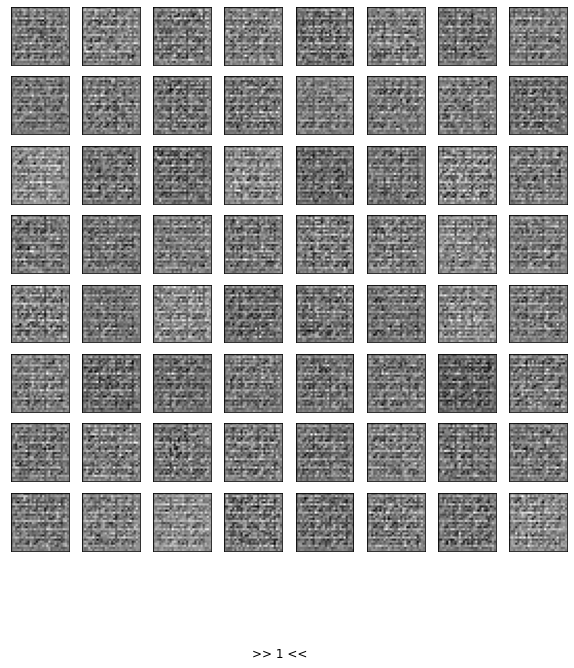

In [ ]:
experiment_name = 'complexw_mnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

# FashionMNIST GAN

## Additional training parameters

In [ ]:
IMAGE_SIZE = 28
NUM_CHANNELS = 1

## Reload and transform

Consideramos que hay suficiente cantidad de ejemplos para cada clase sin problemas de desbalances, por esa razón no vamos a estar utilizando ninguna técnica de data augmentation ni de balanceo.

In [ ]:
transformations = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
fmnist_train = datasets.FashionMNIST(root='./data', train=True, download=True, transform=transformations)
fmnist_test = datasets.FashionMNIST(root='./data', train=False, download=True, transform=transformations)

## Data partition

In [ ]:
targets = fmnist_train.targets

In [ ]:
train_idx, valid_idx= train_test_split(np.arange(len(fmnist_train)), test_size=0.2, shuffle=True, stratify=targets)

train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)

## Loaders

In [ ]:
train_loader = torch.utils.data.DataLoader(fmnist_train, batch_size=BATCH_SIZE, shuffle=True, pin_memory=True, num_workers=NUM_WORKERS)
# val_loader = torch.utils.data.DataLoader(fmnist_train, batch_size=BATCH_SIZE, sampler=valid_sampler, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

test_loader = DataLoader(fmnist_test, batch_size=BATCH_SIZE, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

print(f"{len(fmnist_train):,} Training images. \n{len(fmnist_test):,} Test images.")

60,000 Training images. 
10,000 Test images.


## Simple Models

### Generator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, width: int, height: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope
        self.channels = channels
        
        self.fc1 = nn.Linear(latent_vector_size, 256)
        self.fc2 = nn.Linear(256, 512)
        self.fc3 = nn.Linear(512, 1024)
        self.fc4 = nn.Linear(1024, channels * width * height)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = F.tanh(self.fc4(x))
        return output

### Discriminator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleDiscriminator(nn.Module):
    def __init__(self, width: int, height: int, channels: int = 1, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope

        self.fc1 = nn.Linear(channels * width * height, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, num_classes)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x.view(x.shape[0], -1)), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = self.fc4(x)
        return output

### Models creation

In [ ]:
simple_generator = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope = 0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/generator_XXX_ck.pt'))

In [ ]:
summary(simple_generator, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 784]                  --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 784]                  803,600
Total params: 1,486,352
Trainable params: 1,486,352
Non-trainable params: 0
Total mult-adds (M): 1.49
Input size (MB): 0.00
Forward/backward pass size (MB): 0.02
Params size (MB): 5.95
Estimated Total Size (MB): 5.97

In [ ]:
simple_discriminator = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope=0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/discriminator_XXX_ck.pt'))

In [ ]:
summary(simple_discriminator, (1, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 803,840
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 1,460,225
Trainable params: 1,460,225
Non-trainable params: 0
Total mult-adds (M): 1.46
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 5.84
Estimated Total Size (MB): 5.86

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generator.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminator.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgs_generated = training_GANs(generator=simple_generator, discriminator=simple_discriminator, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simple_fmnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

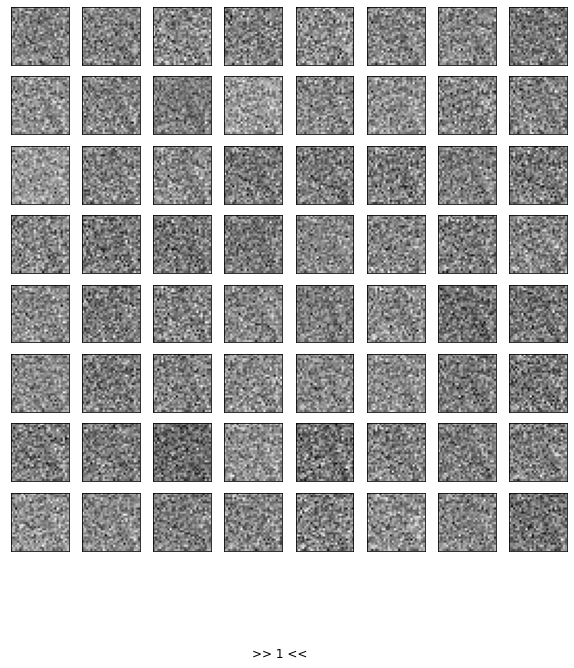

In [ ]:
experiment_name = 'simple_fmnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Simple Models with initial weights

### Models creation

In [ ]:
simple_generatorw = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope = 0.2).to(DEVICE)
simple_generatorw.apply(weights_init)

SimpleGenerator(
  (fc1): Linear(in_features=100, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=1024, bias=True)
  (fc4): Linear(in_features=1024, out_features=784, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_generatorw, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 784]                  --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 784]                  803,600
Total params: 1,486,352
Trainable params: 1,486,352
Non-trainable params: 0
Total mult-adds (M): 1.49
Input size (MB): 0.00
Forward/backward pass size (MB): 0.02
Params size (MB): 5.95
Estimated Total Size (MB): 5.97

In [ ]:
simple_discriminatorw = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, negative_slope=0.2).to(DEVICE)
simple_discriminatorw.apply(weights_init)

SimpleDiscriminator(
  (fc1): Linear(in_features=784, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=1, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_discriminatorw, (1, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 803,840
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 1,460,225
Trainable params: 1,460,225
Non-trainable params: 0
Total mult-adds (M): 1.46
Input size (MB): 0.00
Forward/backward pass size (MB): 0.01
Params size (MB): 5.84
Estimated Total Size (MB): 5.86

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgsw_generated = training_GANs(generator=simple_generatorw, discriminator=simple_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simplew_fmnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

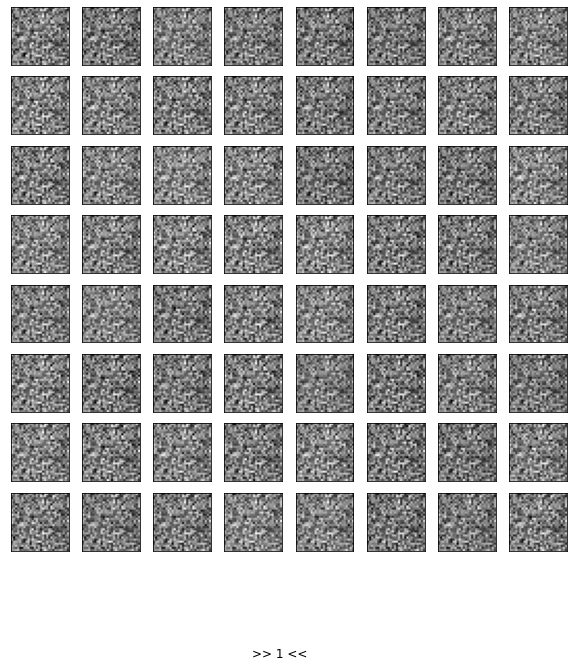

In [ ]:
experiment_name = 'simplew_fmnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Complex Models with initial weights

### More additional training parameters

In [ ]:
# Size of feature maps in generator and discriminator
GENERATOR_FEATURES_MAP_SIZE = 28
DISCRIMINATOR_FEATURES_MAP_SIZE = 28

### Generator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, output_size: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.channels = channels
        
        self.sequential = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_vector_size, out_channels=output_size * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.ReLU(True),
            # state size. (os*8) x 4 x 4
            nn.ConvTranspose2d(output_size * 8, output_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.ReLU(True),
            # state size. (os*4) x 8 x 8
            nn.ConvTranspose2d( output_size * 4, output_size, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size),
            nn.ReLU(True),
            # state size. (os) x 14 x 14
            nn.ConvTranspose2d(output_size, channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 28 x 28
        )
  
    def forward(self, x):
        return self.sequential(x)

### Discriminator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexDiscriminator(nn.Module):
    def __init__(self, input_channels: int, output_size: int, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.sequential = nn.Sequential(
            # input is (ic) x 28 x 28
            nn.Conv2d(input_channels, output_size, 4, 1, 0, bias=False),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os) x 25 x 25
            nn.Conv2d(output_size, output_size * 2, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 2),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*2) x 13 x 13
            nn.Conv2d(output_size * 2, output_size * 4, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*4) x 7 x 7
            nn.Conv2d(output_size * 4, output_size * 8, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*8) x 4 x 4
            nn.Conv2d(output_size * 8, num_classes, 4, 1, 0, bias=False)
            # state size. (nc) x 1 x 1
        )
  
    def forward(self, x):
        return self.sequential(x)

### Models creation

In [ ]:
complex_generatorw = ComplexGenerator(latent_vector_size=LATENT_VECTOR_SIZE, output_size=GENERATOR_FEATURES_MAP_SIZE, negative_slope = 0.2).to(DEVICE)
complex_generatorw.apply(weights_init)

ComplexGenerator(
  (sequential): Sequential(
    (0): ConvTranspose2d(100, 224, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(224, 112, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(112, 28, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(28, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(28, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)

In [ ]:
summary(complex_generatorw, (1, LATENT_VECTOR_SIZE, 1, 1))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexGenerator                         [1, 1, 28, 28]            --
├─Sequential: 1-1                        [1, 1, 28, 28]            --
│    └─ConvTranspose2d: 2-1              [1, 224, 4, 4]            358,400
│    └─BatchNorm2d: 2-2                  [1, 224, 4, 4]            448
│    └─ReLU: 2-3                         [1, 224, 4, 4]            --
│    └─ConvTranspose2d: 2-4              [1, 112, 8, 8]            401,408
│    └─BatchNorm2d: 2-5                  [1, 112, 8, 8]            224
│    └─ReLU: 2-6                         [1, 112, 8, 8]            --
│    └─ConvTranspose2d: 2-7              [1, 28, 14, 14]           12,544
│    └─BatchNorm2d: 2-8                  [1, 28, 14, 14]           56
│    └─ReLU: 2-9                         [1, 28, 14, 14]           --
│    └─ConvTranspose2d: 2-10             [1, 1, 28, 28]            448
│    └─Tanh: 2-11                        [1, 1, 28, 28]            -

In [ ]:
complex_discriminatorw = ComplexDiscriminator(input_channels=1, output_size=DISCRIMINATOR_FEATURES_MAP_SIZE, negative_slope=0.2).to(DEVICE)
complex_discriminatorw.apply(weights_init)

ComplexDiscriminator(
  (sequential): Sequential(
    (0): Conv2d(1, 28, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(28, 56, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(56, 112, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(112, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(112, 224, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(224, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(224, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
)

In [ ]:
summary(complex_discriminatorw, (1, NUM_CHANNELS, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexDiscriminator                     [1, 1, 1, 1]              --
├─Sequential: 1-1                        [1, 1, 1, 1]              --
│    └─Conv2d: 2-1                       [1, 28, 25, 25]           448
│    └─LeakyReLU: 2-2                    [1, 28, 25, 25]           --
│    └─Conv2d: 2-3                       [1, 56, 13, 13]           6,272
│    └─BatchNorm2d: 2-4                  [1, 56, 13, 13]           112
│    └─LeakyReLU: 2-5                    [1, 56, 13, 13]           --
│    └─Conv2d: 2-6                       [1, 112, 7, 7]            25,088
│    └─BatchNorm2d: 2-7                  [1, 112, 7, 7]            224
│    └─LeakyReLU: 2-8                    [1, 112, 7, 7]            --
│    └─Conv2d: 2-9                       [1, 224, 4, 4]            100,352
│    └─BatchNorm2d: 2-10                 [1, 224, 4, 4]            448
│    └─LeakyReLU: 2-11                   [1, 224, 4, 4]            --

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, 1, 1, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(complex_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(complex_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgscw_generated = training_GANs(generator=complex_generatorw, discriminator=complex_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='complexw_fmnist', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE, conv_transpose=True)

### Results

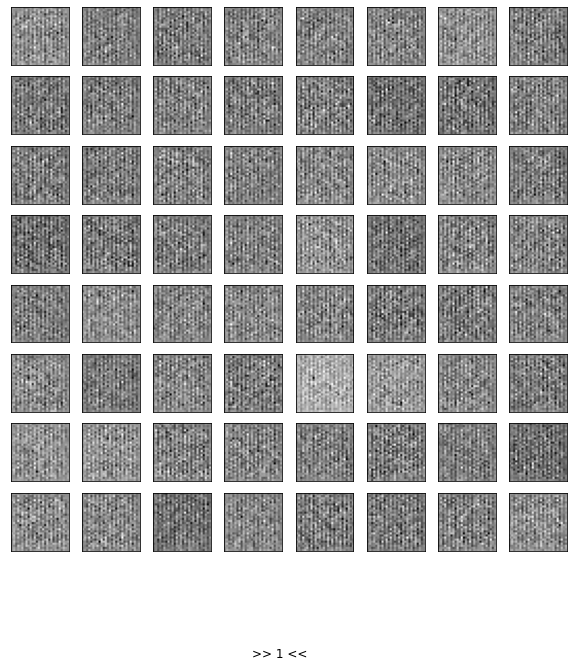

In [ ]:
experiment_name = 'complexw_fmnist'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

# CIFAR-10 GAN

## Additional training parameters

In [ ]:
IMAGE_SIZE = 32
NUM_CHANNELS = 3

## Reload and transform

Consideramos que hay suficiente cantidad de ejemplos para cada clase sin problemas de desbalances, por esa razón no vamos a estar utilizando ninguna técnica de data augmentation ni de balanceo.

In [ ]:
transformations = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
cifar10_train = datasets.CIFAR10(root='./data', train=True, download=True, transform=transformations)
cifar10_test = datasets.CIFAR10(root='./data', train=False, download=True, transform=transformations)

Files already downloaded and verified
Files already downloaded and verified


## Data partition

In [ ]:
targets = cifar10_train.targets

In [ ]:
train_idx, valid_idx= train_test_split(np.arange(len(cifar10_train)), test_size=0.2, shuffle=True, stratify=targets)

train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)

## Loaders

In [ ]:
train_loader = torch.utils.data.DataLoader(cifar10_train, batch_size=BATCH_SIZE, shuffle=True, pin_memory=True, num_workers=NUM_WORKERS)
# val_loader = torch.utils.data.DataLoader(cifar10_train, batch_size=BATCH_SIZE, sampler=valid_sampler, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

test_loader = DataLoader(cifar10_test, batch_size=BATCH_SIZE, shuffle=False, pin_memory=True, num_workers=NUM_WORKERS)

print(f"{len(cifar10_train):,} Training images. \n{len(cifar10_test):,} Test images.")

50,000 Training images. 
10,000 Test images.


## Simple Models

### Generator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, width: int, height: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope
        self.channels = channels

        self.fc1 = nn.Linear(latent_vector_size, 256)
        self.fc2 = nn.Linear(256, 512)
        self.fc3 = nn.Linear(512, 1024)
        self.fc4 = nn.Linear(1024, channels * width * height)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = F.tanh(self.fc4(x))
        return output

### Discriminator

In [ ]:
# code inspired from https://nn.labml.ai/gan/index.html
class SimpleDiscriminator(nn.Module):
    def __init__(self, width: int, height: int, channels: int = 1, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.negative_slope = negative_slope

        self.fc1 = nn.Linear(channels * width * height, 1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc3 = nn.Linear(512, 256)
        self.fc4 = nn.Linear(256, num_classes)
        self.dropout = nn.Dropout(0.2)
  
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x.view(x.shape[0], -1)), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc2(x), self.negative_slope)
        x = self.dropout(x)
        x = F.leaky_relu(self.fc3(x), self.negative_slope)
        x = self.dropout(x)
        output = self.fc4(x)
        return output

### Models creation

In [ ]:
simple_generator = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, channels=NUM_CHANNELS, negative_slope = 0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/generator_XXX_ck.pt'))

In [ ]:
summary(simple_generator, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 3072]                 --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 3072]                 3,148,800
Total params: 3,831,552
Trainable params: 3,831,552
Non-trainable params: 0
Total mult-adds (M): 3.83
Input size (MB): 0.00
Forward/backward pass size (MB): 0.04
Params size (MB): 15.33
Estimated Total Size (MB): 15.37

In [ ]:
simple_discriminator = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, channels=NUM_CHANNELS, negative_slope=0.2).to(DEVICE)

In [ ]:
# simple_generator.load_state_dict(torch.load('./models/discriminator_XXX_ck.pt'))

In [ ]:
summary(simple_discriminator, (1, NUM_CHANNELS, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 3,146,752
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 3,803,137
Trainable params: 3,803,137
Non-trainable params: 0
Total mult-adds (M): 3.80
Input size (MB): 0.01
Forward/backward pass size (MB): 0.01
Params size (MB): 15.21
Estimated Total Size (MB): 15.24

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generator.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminator.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgs_generated = training_GANs(generator=simple_generator, discriminator=simple_discriminator, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simple_cifar10', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

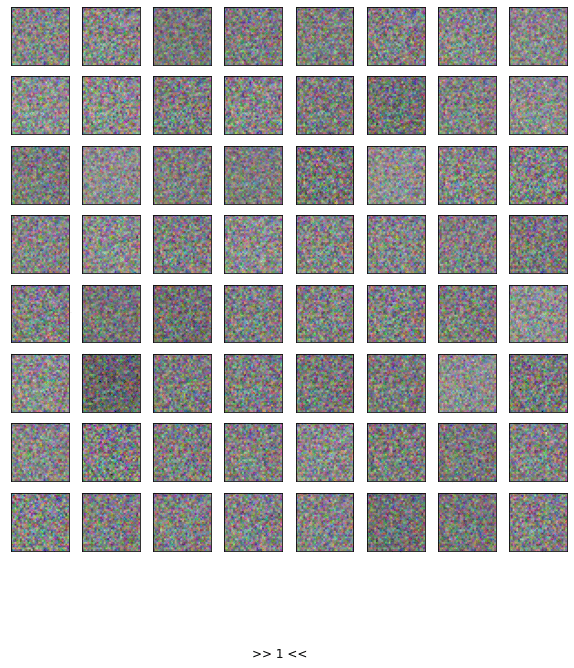

In [ ]:
experiment_name = 'simple_cifar10'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Simple Models with initial weights

### Models creation

In [ ]:
simple_generatorw = SimpleGenerator(latent_vector_size=LATENT_VECTOR_SIZE, width=IMAGE_SIZE, height=IMAGE_SIZE, channels=NUM_CHANNELS, negative_slope = 0.2).to(DEVICE)
simple_generatorw.apply(weights_init)

SimpleGenerator(
  (fc1): Linear(in_features=100, out_features=256, bias=True)
  (fc2): Linear(in_features=256, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=1024, bias=True)
  (fc4): Linear(in_features=1024, out_features=3072, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_generatorw, (1, LATENT_VECTOR_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleGenerator                          [1, 3072]                 --
├─Linear: 1-1                            [1, 256]                  25,856
├─Dropout: 1-2                           [1, 256]                  --
├─Linear: 1-3                            [1, 512]                  131,584
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 1024]                 525,312
├─Dropout: 1-6                           [1, 1024]                 --
├─Linear: 1-7                            [1, 3072]                 3,148,800
Total params: 3,831,552
Trainable params: 3,831,552
Non-trainable params: 0
Total mult-adds (M): 3.83
Input size (MB): 0.00
Forward/backward pass size (MB): 0.04
Params size (MB): 15.33
Estimated Total Size (MB): 15.37

In [ ]:
simple_discriminatorw = SimpleDiscriminator(width=IMAGE_SIZE, height=IMAGE_SIZE, channels=NUM_CHANNELS, negative_slope=0.2).to(DEVICE)
simple_discriminatorw.apply(weights_init)

SimpleDiscriminator(
  (fc1): Linear(in_features=3072, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=256, bias=True)
  (fc4): Linear(in_features=256, out_features=1, bias=True)
  (dropout): Dropout(p=0.2, inplace=False)
)

In [ ]:
summary(simple_discriminatorw, (1, NUM_CHANNELS, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
SimpleDiscriminator                      [1, 1]                    --
├─Linear: 1-1                            [1, 1024]                 3,146,752
├─Dropout: 1-2                           [1, 1024]                 --
├─Linear: 1-3                            [1, 512]                  524,800
├─Dropout: 1-4                           [1, 512]                  --
├─Linear: 1-5                            [1, 256]                  131,328
├─Dropout: 1-6                           [1, 256]                  --
├─Linear: 1-7                            [1, 1]                    257
Total params: 3,803,137
Trainable params: 3,803,137
Non-trainable params: 0
Total mult-adds (M): 3.80
Input size (MB): 0.01
Forward/backward pass size (MB): 0.01
Params size (MB): 15.21
Estimated Total Size (MB): 15.24

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(simple_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(simple_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgsw_generated = training_GANs(generator=simple_generatorw, discriminator=simple_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='simplew_cifar10', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE)

### Results

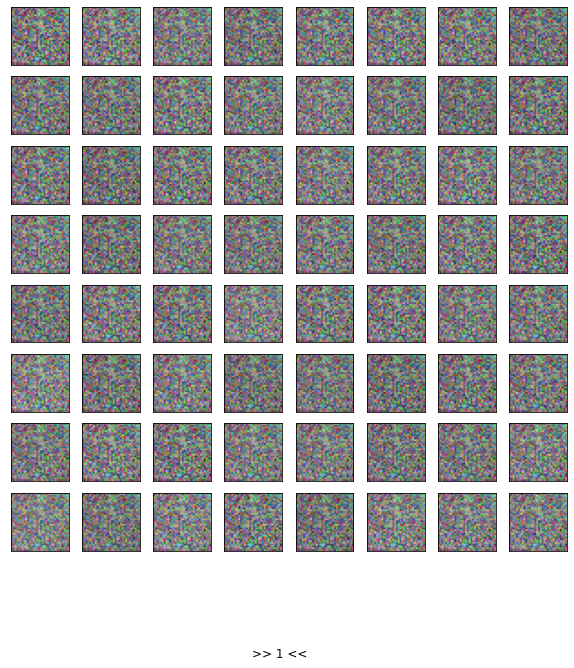

In [ ]:
experiment_name = 'simplew_cifar10'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

## Complex Models with initial weights

### More additional training parameters

In [ ]:
# Size of feature maps in generator and discriminator
GENERATOR_FEATURES_MAP_SIZE = 32
DISCRIMINATOR_FEATURES_MAP_SIZE = 32

### Generator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexGenerator(nn.Module):
    def __init__(self, latent_vector_size: int, output_size: int, channels: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.channels = channels

        self.sequential = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_vector_size, out_channels=output_size * 8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.ReLU(inplace=True),
            # state size. (os*8) x 4 x 4
            nn.ConvTranspose2d(output_size * 8, output_size * 4, 2, 2, 0, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.ReLU(inplace=True),
            # state size. (os*4) x 8 x 8
            nn.ConvTranspose2d( output_size * 4, output_size, 2, 2, 0, bias=False),
            nn.BatchNorm2d(output_size),
            nn.ReLU(inplace=True),
            # state size. (os) x 16 x 16
            nn.ConvTranspose2d(output_size, channels, 2, 2, 0, bias=False),
            nn.Tanh()
            # state size. (nc) x 32 x 32
        )
  
    def forward(self, x):
        return self.sequential(x)

### Discriminator

In [ ]:
# code inspired from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
class ComplexDiscriminator(nn.Module):
    def __init__(self, input_channels: int, output_size: int, num_classes: int = 1, negative_slope: float = 0.01):
        super().__init__()
        self.sequential = nn.Sequential(
            # input is (ic) x 32 x 32
            nn.Conv2d(input_channels, output_size, 4, 1, 0, bias=False),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os) x 29 x 29
            nn.Conv2d(output_size, output_size * 2, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 2),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*2) x 15 x 15
            nn.Conv2d(output_size * 2, output_size * 4, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 4),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*4) x 8 x 8
            nn.Conv2d(output_size * 4, output_size * 8, 2, 2, 1, bias=False),
            nn.BatchNorm2d(output_size * 8),
            nn.LeakyReLU(negative_slope, inplace=True),
            # state size. (os*8) x 5 x 5
            nn.Conv2d(output_size * 8, num_classes, 4, 2, 0, bias=False)
            # state size. (nc) x 1 x 1
        )
  
    def forward(self, x):
        return self.sequential(x)

### Models creation

In [ ]:
complex_generatorw = ComplexGenerator(latent_vector_size=LATENT_VECTOR_SIZE, output_size=GENERATOR_FEATURES_MAP_SIZE, channels=NUM_CHANNELS, negative_slope = 0.2).to(DEVICE)
complex_generatorw.apply(weights_init)

ComplexGenerator(
  (sequential): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(2, 2), stride=(2, 2), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 32, kernel_size=(2, 2), stride=(2, 2), bias=False)
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(32, 3, kernel_size=(2, 2), stride=(2, 2), bias=False)
    (10): Tanh()
  )
)

In [ ]:
summary(complex_generatorw, (1, LATENT_VECTOR_SIZE, 1, 1))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexGenerator                         [1, 3, 32, 32]            --
├─Sequential: 1-1                        [1, 3, 32, 32]            --
│    └─ConvTranspose2d: 2-1              [1, 256, 4, 4]            409,600
│    └─BatchNorm2d: 2-2                  [1, 256, 4, 4]            512
│    └─ReLU: 2-3                         [1, 256, 4, 4]            --
│    └─ConvTranspose2d: 2-4              [1, 128, 8, 8]            131,072
│    └─BatchNorm2d: 2-5                  [1, 128, 8, 8]            256
│    └─ReLU: 2-6                         [1, 128, 8, 8]            --
│    └─ConvTranspose2d: 2-7              [1, 32, 16, 16]           16,384
│    └─BatchNorm2d: 2-8                  [1, 32, 16, 16]           64
│    └─ReLU: 2-9                         [1, 32, 16, 16]           --
│    └─ConvTranspose2d: 2-10             [1, 3, 32, 32]            384
│    └─Tanh: 2-11                        [1, 3, 32, 32]            -

In [ ]:
complex_discriminatorw = ComplexDiscriminator(input_channels=NUM_CHANNELS, output_size=DISCRIMINATOR_FEATURES_MAP_SIZE, negative_slope=0.2).to(DEVICE)
complex_discriminatorw.apply(weights_init)

ComplexDiscriminator(
  (sequential): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(2, 2), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(256, 1, kernel_size=(4, 4), stride=(2, 2), bias=False)
  )
)

In [ ]:
summary(complex_discriminatorw, (1, NUM_CHANNELS, IMAGE_SIZE, IMAGE_SIZE))

Layer (type:depth-idx)                   Output Shape              Param #
ComplexDiscriminator                     [1, 1, 1, 1]              --
├─Sequential: 1-1                        [1, 1, 1, 1]              --
│    └─Conv2d: 2-1                       [1, 32, 29, 29]           1,536
│    └─LeakyReLU: 2-2                    [1, 32, 29, 29]           --
│    └─Conv2d: 2-3                       [1, 64, 15, 15]           8,192
│    └─BatchNorm2d: 2-4                  [1, 64, 15, 15]           128
│    └─LeakyReLU: 2-5                    [1, 64, 15, 15]           --
│    └─Conv2d: 2-6                       [1, 128, 8, 8]            32,768
│    └─BatchNorm2d: 2-7                  [1, 128, 8, 8]            256
│    └─LeakyReLU: 2-8                    [1, 128, 8, 8]            --
│    └─Conv2d: 2-9                       [1, 256, 5, 5]            131,072
│    └─BatchNorm2d: 2-10                 [1, 256, 5, 5]            512
│    └─LeakyReLU: 2-11                   [1, 256, 5, 5]            

### Training

In [ ]:
# Initialize loss function
criterion = nn.BCEWithLogitsLoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(BATCH_SIZE, LATENT_VECTOR_SIZE, 1, 1, device=DEVICE)

# Setup Adam optimizers for both generator and discriminator
optimizerG = torch.optim.Adam(complex_generatorw.parameters(), lr=LR, betas=(BETA1, 0.999))
optimizerD = torch.optim.Adam(complex_discriminatorw.parameters(), lr=LR, betas=(BETA1, 0.999))

In [ ]:
imgscw_generated = training_GANs(generator=complex_generatorw, discriminator=complex_discriminatorw, 
                train_loader=train_loader,
                criterion=criterion, optimizerG=optimizerG, optimizerD=optimizerD,
                number_epochs=NUM_EPOCHS, writer_name='complexw_cifar10', latent_vector_size=LATENT_VECTOR_SIZE,
                fixed_noise=fixed_noise, channels=NUM_CHANNELS, image_size=IMAGE_SIZE, conv_transpose=True)

### Results

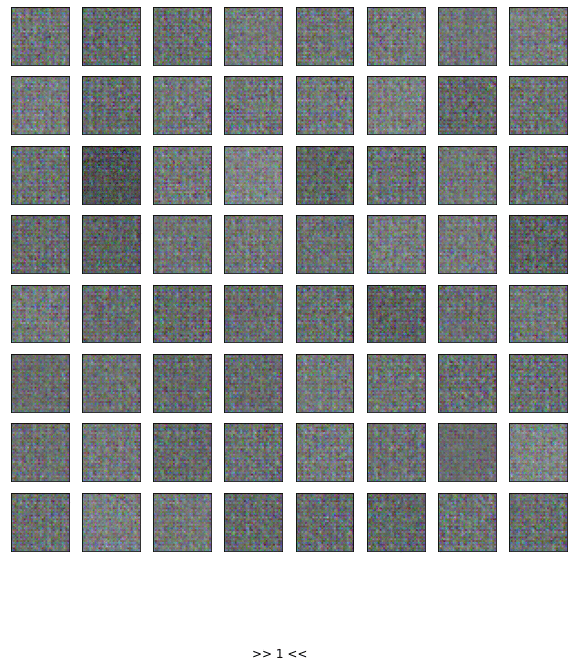

In [ ]:
experiment_name = 'complexw_cifar10'
with open(f'./generated_images/imgs_generated_{experiment_name}.pkl', 'rb') as f:
    imgs_generated = pkl.load(f)
show_gan_progress(imgs_generated, './gifs/evaluation_'+experiment_name, batch_size=BATCH_SIZE)

# Training stats

In [ ]:
%load_ext tensorboard
%tensorboard  --logdir='./runs'

<IPython.core.display.Javascript object>

# Conclusion

En este trabajo obligatorio presentamos todas las premisas solicitadas en los requerimientos:
 
 
*  Correcta implementación de una red GAN.
*  Variedad de modelos desde la red simple, pasando por la red simple con pesos iniciales hasta la implementación compleja de una red DCGAN.
*  Entrenamiento y generación usando los distintos datasets planteados: MNIST, FashionMNIST y CIFAR10.
 
Partiendo de 3 arquitecturas base (simple, simple con pesos y DCGAN) las mismas fueron entrenadas con los datasets mencionados anteriormente logrando buenos resultados. Cabe destacar que para el caso de CIFAR10 las arquitecturas base fueron modificadas para tomar en cuenta las particularidades del data set: 3 canales RGB (*MNIST es escala de grises por lo tanto es 1 canal) y tamaño de imágen 32x32 píxeles (28x28 en el caso de los otros datasets).
 
A continuación presentamos una serie de GIFs con la evolución del entrenamiento de cada arquitectura sobre cada uno de los datasets y conclusiones particulares de cada caso.


## MNIST

,,

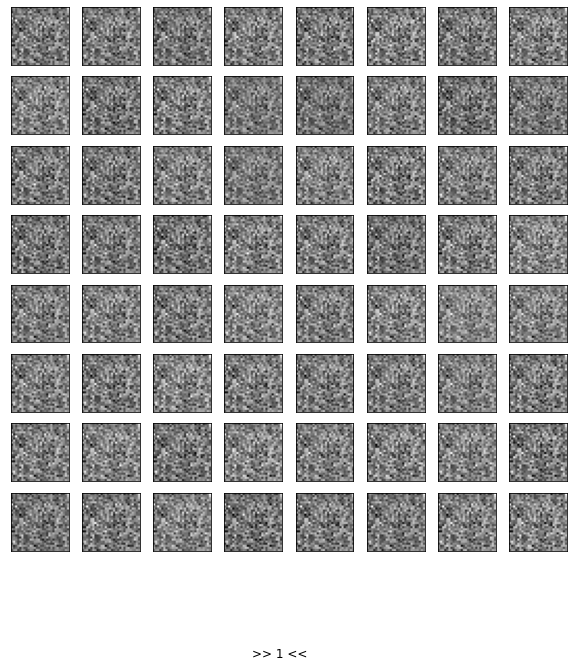
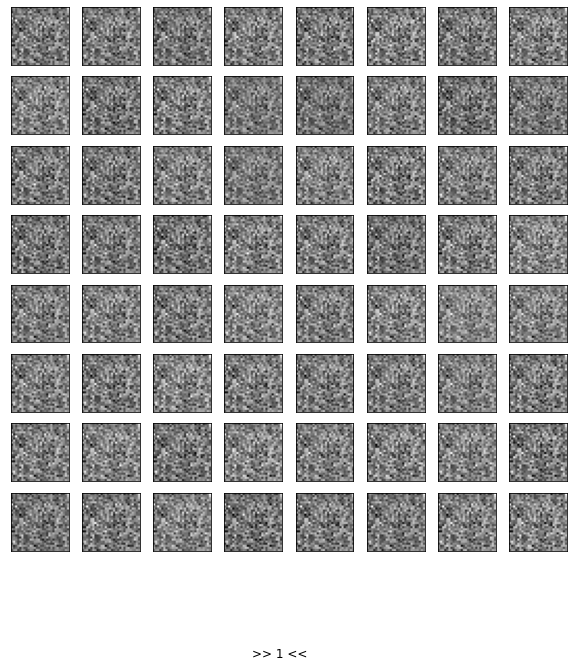
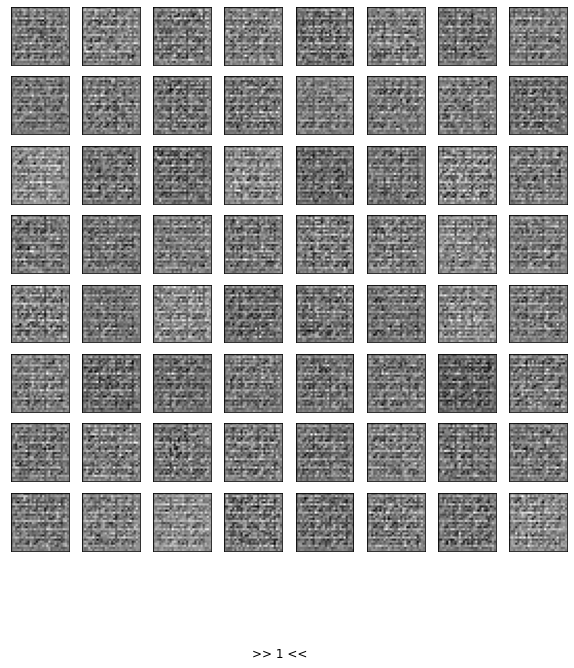

In [ ]:
show_gif_comparison(gif_simple='simplew_mnist', gif_simplew='simplew_mnist', gif_complexw='complexw_mnist')

Puede apreciarse que las 3 arquitecturas partiendo de un espacio latente (ruido) en un vector de tamaño 100 logran generar dígitos que se asemejan a los del dataset.
 
En el TensorBoard mostrado en la sección anterior se puede ver que el modelo complejo tiende rápidamente al *overfit* en el generador. Esto puede verse en el GIF notando que las imágenes generadas se degradan a mayor velocidad que las de los modelos simples. Esto se puede ver claramente en el 8 presente en la fila 1 columna 2.
 
Otra cosa que puede apreciarse en las redes simples es una mayor cantidad de 1 sobre el resto de los dígitos. Dado que el entrenamiento es genérico (buscar representar todos los dígitos) y las redes tienen unas pocas capas lineales la misma tiende a generar aquellos números más simples como el 1 o el 7. Esto no sucede en la red compleja basada en DCGAN.
 
Si tuviésemos que seleccionar alguna de las arquitecturas sería la simple. Para esto nos basamos en el principio de la navaja de Occam ya que para resultados similares preferimos usar la arquitectura más simple. Si bien la DCGAN logró resultados que a priori son superiores el costo de entrenar la misma es mayor que el de las arquitecturas simples (en el entorno de 60 hs vs 36 hs).

## FashionMNIST

,,

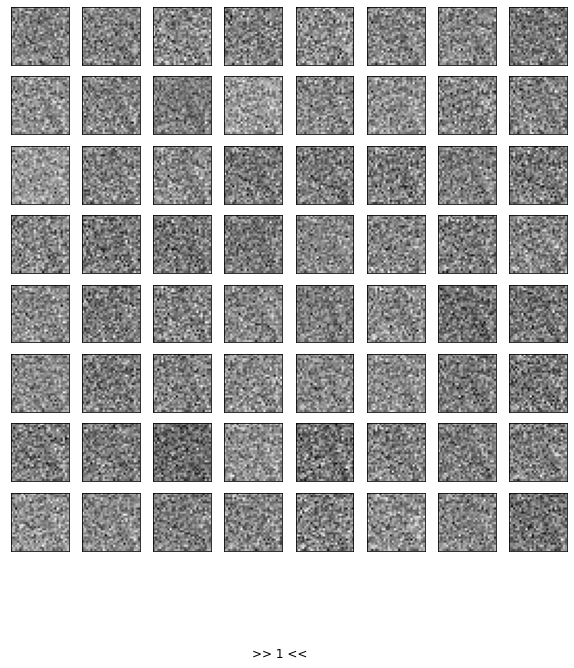
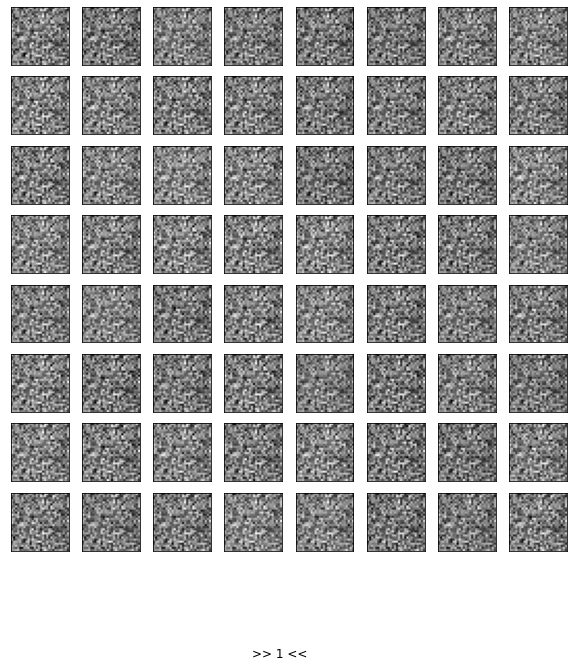
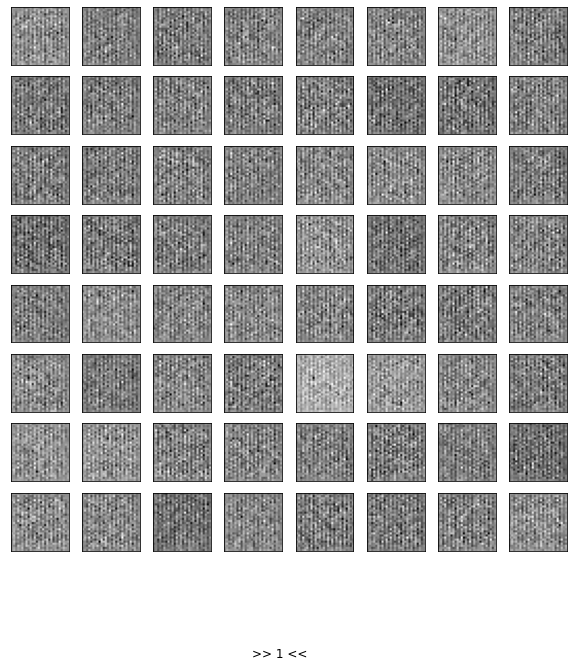

In [ ]:
show_gif_comparison(gif_simple='simple_fmnist', gif_simplew='simplew_fmnist', gif_complexw='complexw_fmnist')

Para el caso de FashionMNIST las mismas conclusiones presentadas en MNIST aplican. De todas formas, es interesante ver los resultados obtenidos en el TensorBoard ya que en este caso, el modelo complejo también tiende al *overfitting* en las sucesivas epochs de entrenamiento pero la "velocidad" a la que lo hace es menor que con MNIST. Esto se puede explicar por la complejidad de las imágenes del dataset. Claramente es más complejo recrear ropa desde un espacio latente (también vector de 100) que dígitos.
 
De todas formas, si tuviésemos que elegir una arquitectura nuevamente seleccionaremos la simple. Los tiempos de entrenamiento para este dataset fueron similares a los de MNIST.

## CIFAR10

,,

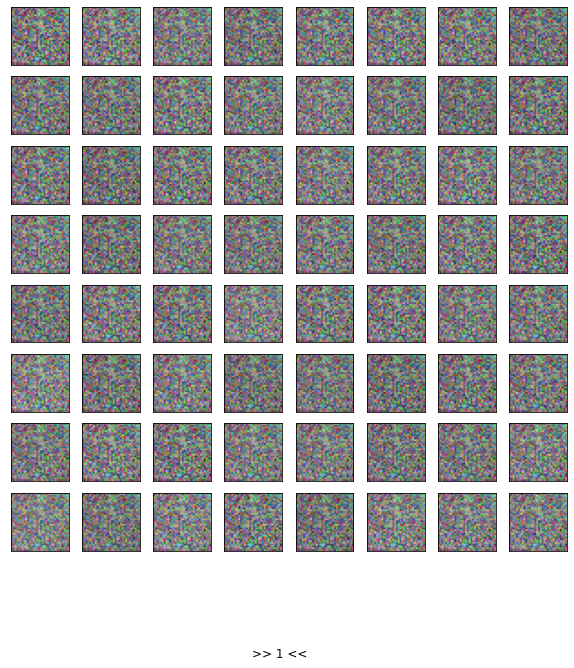
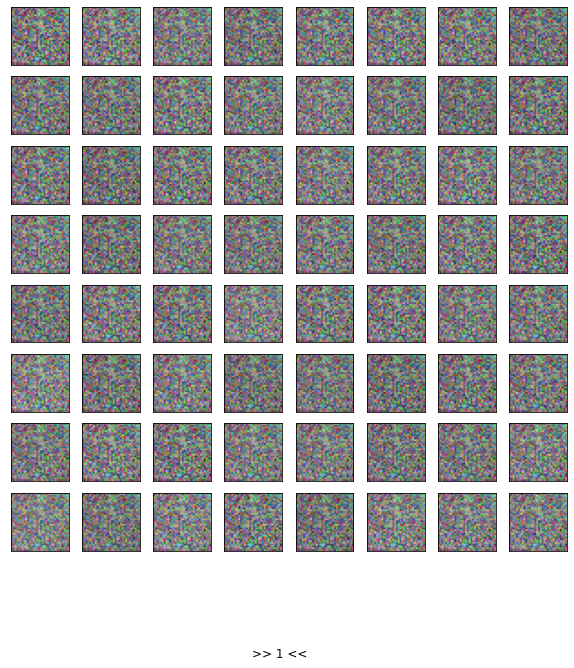
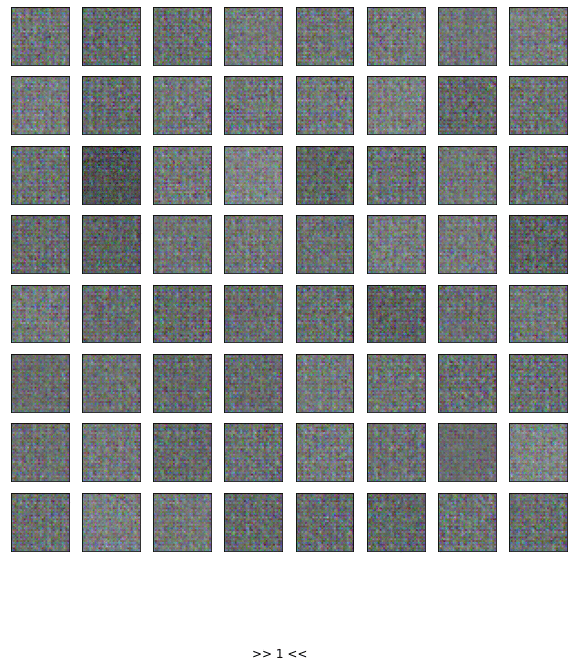

In [ ]:
show_gif_comparison(gif_simple='simplew_cifar10', gif_simplew='simplew_cifar10', gif_complexw='complexw_cifar10')

El dataset de CIFAR10 es el más complejo ya que presenta colores (RGB) y una amplia variedad de objetos de 10 clases tan disímiles como lo es un avión de una rana.
 
En los GIFs puede observarse que las 2 arquitecturas simples, logran generar imágenes que pueden llegar a interpretarse como pertenecientes a alguna de las 10 categorías del dataset.
 
La red compleja basada en DCGAN si bien genera, a priori y por lo menos para el ojo humano no logra generar imágenes que puedan ser fácilmente asociadas a una categoría. En las arquitecturas simples se usó una capa de *dropout* al 20% al final de todas las capas. Un experimento a realizar con la red compleja es realizar regularización y entrenar con una cantidad de epochs mayor a 2000.
 
A modo de referencia, la red compleja demoró en el entorno de 72 horas en ser entrenada y las redes simples en el entorno de 48.
 
Nuevamente y si se fuese a elegir una arquitectura, se iría por la simple aunque de aplicarse una adecuada regularización se podría ir por una arquitectura compleja. Otra alternativa podría ser usar *transfer learning* para reducir los tiempos de entrenamiento aplicando algún modelo previamente entrenado. De esto último existe el siguiente material para ampliar:
 
 
*  [Mind2Mind : transfer learning for GANs](https://arxiv.org/abs/1906.11613)
*  [Transferring GANs: generating images from
limited data](https://openaccess.thecvf.com/content_ECCV_2018/papers/yaxing_wang_Transferring_GANs_generating_ECCV_2018_paper.pdf)
*  [Generative Adversarial Networks and Transfer Learning](https://jovian.ai/learn/deep-learning-with-pytorch-zero-to-gans/lesson/lesson-6-image-generation-using-gans)
 


## Reflexiones finales

El obligatorio presentó una oportunidad de aplicar de forma práctica varios de los tópicos vistos durante el curso y también para profundizar e investigar un tema basado en el estado del arte de deep learning.
 
Si bien es cierto que hay nuevas arquitecturas que permiten generar imágenes con mayor nivel de complejidad o imágenes a partir de texto por los *diffusion models*. Entendemos que las GANS presentan una arquitectura y modelo relativamente simple de entender y de implementar.
 
En este trabajo hemos logrado desarrollar, entrenar y evaluar distintas arquitecturas para el generador y el discriminador además de haber aprendido, entre otros, el concepto de trasposición de la convolución (que busca expandir en lugar de reducir) dado que nuestro objetivo es generar imágenes a partir de ruido; o la función de activación *leaky relu* que permite tener valores inferiores a 0 a diferencia de la *relu*.

# Repositorio de GitHub

Dado que los modelos resultantes de las distintas ejecuciones superan el tamaño máximo que puede ser subido en el sistema de Gestión de ORT optamos por dejar los mismos más todo el material usado en este obligatorio en un repositorio de GitHub.


Recomendamos abrir la notebook a través de Google Colab para que el contenido multimedia de la misma se muestre de forma apropiada.

El repositorio está disponible en el siguiente enlace: [https://github.com/fededemo/ObligatorioTallerDeepLearning](https://github.com/fededemo/ObligatorioTallerDeepLearning).

